## Setup

In [1]:
import os
import json
import glob
import torch
import re
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
#import seaborn as sns
import matplotlib.pyplot as plt
#from joypy import joyplot

### Retrieving Data

#### Circuit Data

In [2]:
def read_json_file(file_path):
    with open(file_path, 'r') as file:
        return json.load(file)


def load_edge_scores_into_dictionary(folder_path):
    file_paths = glob.glob(f'{folder_path}/*.json')

    # Create an empty DataFrame to store all edge scores
    all_edges = pd.DataFrame()

    for i, file_path in enumerate(file_paths):
        print(f'Processing file {i+1}/{len(file_paths)}: {file_path}')
        data = read_json_file(file_path)
        edges = data['edges']
        scores = [edge['score'] for edge in edges.values()]
        circuit_inclusion = [edge['in_graph'] for edge in edges.values()]
        edge_names = [edge for edge in edges.keys()]

        # Extract checkpoint name from the filename
        checkpoint_name = int(os.path.basename(file_path).replace('.json', ''))
        #checkpoint_name = f'step {checkpoint_name}'

        checkpoint_df = pd.DataFrame({'edge': edge_names, 'score': scores, 'in_circuit': circuit_inclusion, 'checkpoint': checkpoint_name})
        all_edges = pd.concat([all_edges, checkpoint_df])

    all_edges = all_edges.sort_values('checkpoint')
    return all_edges

#### Performance Data

In [3]:
def get_checkpoint_names(mode: str = "linear"):
    if mode == "linear":
        ckpts = [i * 1000 for i in range(1, 144)]
    elif mode == "exponential":
        ckpts = [
            round((2**i) / 1000) * 1000 if 2**i > 1000 else 2**i
            for i in range(18)
        ]
    elif mode == "exp_plus_detail":
        ckpts = (
            [2**i for i in range(10)]
            + [i * 1000 for i in range(1, 16)]
            + [i * 5000 for i in range(4, 14)]
            + [i * 10000 for i in range(7, 15)]
            + [143000]
        )
    else:
        ckpts = [1, 2]

    return ckpts

In [4]:
def load_metrics(directory):
    nested_dict = {}

    for model_folder in os.listdir(directory):
        model_path = os.path.join(directory, model_folder)
        if os.path.isdir(model_path) and model_folder != '.ipynb_checkpoints':
            model_key = '-'.join(model_folder.split('-')[:-2])
            metrics_file = os.path.join(model_path, 'metrics.pt')

            if os.path.exists(metrics_file):
                nested_dict[model_key] = torch.load(metrics_file)

                for task_key in nested_dict[model_key].keys():
                    for metric_key in nested_dict[model_key][task_key].keys():
                        metric_values = nested_dict[model_key][task_key][metric_key]
                        # Convert each value to a 1D tensor of regular floats
                        nested_dict[model_key][task_key][metric_key] = torch.tensor([
                            float(value.item() if torch.is_tensor(value) else value) 
                            for value in metric_values.values()
                        ])

    return nested_dict

In [5]:
def aggregate_metrics_to_tensors_step_number(root_folder, shot_name="zero-shot"):
    metric_dictionary = {}
    
    # Regular expression to extract step number from checkpoint name
    step_number_pattern = re.compile(r'_step(\d+)')
    
    # Iterate through the folder structure
    for model_folder in os.listdir(root_folder):
        model_path = os.path.join(root_folder, model_folder)
        if not os.path.isdir(model_path):
            continue  # Skip any files at this level
        
        shot_path = os.path.join(model_path, shot_name)
        if not os.path.exists(shot_path) or not os.path.isdir(shot_path):
            continue  # Skip if the specific shot folder doesn't exist
        
        for filename in os.listdir(shot_path):
            if filename.endswith('.json'):
                file_path = os.path.join(shot_path, filename)
                with open(file_path, 'r') as f:
                    data = json.load(f)
                    for task_name, metrics in data['results'].items():
                        for metric_name, value in metrics.items():
                            if model_folder not in metric_dictionary:
                                metric_dictionary[model_folder] = {}
                            if task_name not in metric_dictionary[model_folder]:
                                metric_dictionary[model_folder][task_name] = {}
                            if metric_name not in metric_dictionary[model_folder][task_name]:
                                metric_dictionary[model_folder][task_name][metric_name] = {}
                            
                            # Extract step number from filename
                            match = step_number_pattern.search(filename)
                            if match:
                                step_number = match.group(1)
                                metric_dictionary[model_folder][task_name][metric_name][step_number] = value
    
    # Convert values to PyTorch tensors
    for model_name, tasks in metric_dictionary.items():
        for task_name, metrics in tasks.items():
            for metric_name, checkpoint_values in metrics.items():
                # Convert the dictionary values to tensors, keys remain the same
                tensor_values = torch.tensor(list(checkpoint_values.values()))
                metric_dictionary[model_name][task_name][metric_name] = dict(zip(checkpoint_values.keys(), tensor_values))
    
    return metric_dictionary

### Metric Functions

In [6]:
def compute_ged(df):
    # Ensure the dataframe is sorted by checkpoint
    df = df.sort_values(by='checkpoint')

    # Get the unique checkpoints
    checkpoints = df['checkpoint'].unique()

    # Initialize a list to store the results
    results = []

    # Iterate over pairs of adjacent checkpoints
    for i in range(len(checkpoints) - 1):
        # Get the sets of edges for each checkpoint
        edges_1 = set(df[(df['checkpoint'] == checkpoints[i]) & (df['in_circuit'] == True)]['edge'])
        edges_2 = set(df[(df['checkpoint'] == checkpoints[i + 1]) & (df['in_circuit'] == True)]['edge'])

        # Calculate the number of additions and deletions
        additions = len(edges_2 - edges_1)
        deletions = len(edges_1 - edges_2)

        # Calculate the total GED
        total_ged = additions + deletions

        # Append the results for this pair of checkpoints
        results.append({
            'checkpoint_1': checkpoints[i],
            'checkpoint_2': checkpoints[i + 1],
            'additions': additions,
            'deletions': deletions,
            'total_ged': total_ged
        })

    # Convert the results to a DataFrame and return
    return pd.DataFrame(results)

In [7]:
def compute_weighted_ged(df):
    # Ensure the dataframe is sorted by checkpoint
    df = df.sort_values(by='checkpoint')

    # Get the unique checkpoints
    checkpoints = df['checkpoint'].unique()

    # Initialize a list to store the results
    results = []

    # Iterate over pairs of adjacent checkpoints
    for i in range(len(checkpoints) - 1):
        # Get the dataframes for each checkpoint
        df1 = df[(df['checkpoint'] == checkpoints[i]) & (df['in_circuit'] == True)]
        df2 = df[(df['checkpoint'] == checkpoints[i + 1]) & (df['in_circuit'] == True)]

        # Calculate the weighted additions and deletions
        additions = df2[~df2['edge'].isin(df1['edge'])]['score'].sum()
        deletions = df1[~df1['edge'].isin(df2['edge'])]['score'].sum()

        # Calculate the total weighted GED
        total_weighted_ged = additions + deletions

        # Append the results for this pair of checkpoints
        results.append({
            'checkpoint_1': checkpoints[i],
            'checkpoint_2': checkpoints[i + 1],
            'weighted_additions': additions,
            'weighted_deletions': deletions,
            'total_weighted_ged': total_weighted_ged
        })

    # Convert the results to a DataFrame and return
    return pd.DataFrame(results)

In [8]:
def compute_gtd(df):
    # Ensure the dataframe is sorted by checkpoint
    df = df.sort_values(by='checkpoint')

    # Get the unique checkpoints
    checkpoints = df['checkpoint'].unique()

    # Initialize a list to store the results
    results = []

    # Iterate over pairs of adjacent checkpoints
    for i in range(len(checkpoints) - 1):
        # Get the dataframes for each checkpoint
        df1 = df[df['checkpoint'] == checkpoints[i]]
        df2 = df[df['checkpoint'] == checkpoints[i + 1]]

        # Merge the dataframes on the edge column
        merged_df = pd.merge(df1, df2, on='edge', suffixes=('_1', '_2'))

        # Calculate the score changes
        merged_df['score_change'] = merged_df['score_2'] - merged_df['score_1']

        # Calculate the weighted additions and deletions
        additions = merged_df[merged_df['score_change'] > 0]['score_change'].sum()
        deletions = -merged_df[merged_df['score_change'] < 0]['score_change'].sum()

        # Calculate the total weighted GTD
        total_weighted_gtd = additions + deletions

        # Append the results for this pair of checkpoints
        results.append({
            'checkpoint_1': checkpoints[i],
            'checkpoint_2': checkpoints[i + 1],
            'summed_increases': additions,
            'summed_decreases': deletions,
            'summed_absolute_change': total_weighted_gtd
        })

    # Convert the results to a DataFrame and return
    return pd.DataFrame(results)

In [9]:
def compute_jaccard_similarity(df):
    # Ensure the dataframe is sorted by checkpoint
    df = df.sort_values(by='checkpoint')

    # Get the unique checkpoints
    checkpoints = df['checkpoint'].unique()

    # Initialize a list to store the results
    results = []

    # Iterate over pairs of adjacent checkpoints
    for i in range(len(checkpoints) - 1):
        # Get the sets of edges for each checkpoint
        edges_1 = set(df[(df['checkpoint'] == checkpoints[i]) & (df['in_circuit'] == True)]['edge'])
        edges_2 = set(df[(df['checkpoint'] == checkpoints[i + 1]) & (df['in_circuit'] == True)]['edge'])

        # Calculate the Jaccard similarity
        intersection = len(edges_1 & edges_2)
        union = len(edges_1 | edges_2)
        jaccard_similarity = intersection / union if union != 0 else 0

        # Append the results for this pair of checkpoints
        results.append({
            'checkpoint_1': checkpoints[i],
            'checkpoint_2': checkpoints[i + 1],
            'jaccard_similarity': jaccard_similarity
        })

    # Convert the results to a DataFrame and return
    return pd.DataFrame(results)

In [10]:
def compute_jaccard_similarity_to_reference(df, reference_checkpoint):
    # Ensure the dataframe is sorted by checkpoint
    df = df.sort_values(by='checkpoint')

    # Get the unique checkpoints
    checkpoints = df['checkpoint'].unique()

    # Initialize a list to store the results
    results = []

    # Get the set of edges for the reference checkpoint
    reference_edges = set(df[(df['checkpoint'] == reference_checkpoint) & (df['in_circuit'] == True)]['edge'])

    # Iterate over all checkpoints
    for checkpoint in checkpoints:
        # Skip the reference checkpoint
        if checkpoint == reference_checkpoint:
            continue

        # Get the set of edges for the current checkpoint
        edges = set(df[(df['checkpoint'] == checkpoint) & (df['in_circuit'] == True)]['edge'])

        # Calculate the Jaccard similarity
        intersection = len(reference_edges & edges)
        union = len(reference_edges | edges)
        jaccard_similarity = intersection / union if union != 0 else 0

        # Append the results for this checkpoint
        results.append({
            'reference_checkpoint': reference_checkpoint,
            'checkpoint': checkpoint,
            'jaccard_similarity': jaccard_similarity
        })

    # Convert the results to a DataFrame and return
    return pd.DataFrame(results)


## Retrieve & Process Data

### Circuit Data

In [43]:
folder_path = 'results/graphs/pythia-160m/ioi'
df = load_edge_scores_into_dictionary(folder_path)

Processing file 1/44: results/graphs/pythia-160m/ioi/6000.json
Processing file 2/44: results/graphs/pythia-160m/ioi/16.json
Processing file 3/44: results/graphs/pythia-160m/ioi/1.json
Processing file 4/44: results/graphs/pythia-160m/ioi/5000.json
Processing file 5/44: results/graphs/pythia-160m/ioi/80000.json
Processing file 6/44: results/graphs/pythia-160m/ioi/8000.json
Processing file 7/44: results/graphs/pythia-160m/ioi/120000.json
Processing file 8/44: results/graphs/pythia-160m/ioi/70000.json
Processing file 9/44: results/graphs/pythia-160m/ioi/2000.json
Processing file 10/44: results/graphs/pythia-160m/ioi/143000.json
Processing file 11/44: results/graphs/pythia-160m/ioi/10000.json
Processing file 12/44: results/graphs/pythia-160m/ioi/65000.json
Processing file 13/44: results/graphs/pythia-160m/ioi/60000.json
Processing file 14/44: results/graphs/pythia-160m/ioi/90000.json
Processing file 15/44: results/graphs/pythia-160m/ioi/1000.json
Processing file 16/44: results/graphs/pythia

In [44]:
# remove checkpoints prior to 4000 from the dataframe
df = df[df['checkpoint'] >= 4000]

In [45]:
# For each checkpoint, get the number of edges in the circuit
num_edges = df.groupby('checkpoint')['in_circuit'].sum()
num_edges = num_edges.reset_index()
num_edges

,checkpoint,in_circuit
0,4000,19
1,5000,45
2,6000,44
3,7000,50
4,8000,49
5,9000,47
6,10000,47
7,11000,119
8,12000,145
9,13000,167


In [46]:
smaller_df = df[df['checkpoint'].isin([2000, 8000, 15000, 30000, 60000, 120000, 140000])]

In [47]:
smaller_df.head()

,edge,score,in_circuit,checkpoint
16175,m4->a8.h2<q>,-1.792908e-04,False,8000
32345,a11.h11->logits,4.215240e-04,False,8000
10774,a0.h10->a7.h2<k>,-1.966953e-05,False,8000
10775,a0.h10->a7.h2<v>,-1.329184e-05,False,8000
10776,a0.h10->a7.h3<q>,7.972121e-07,False,8000


In [48]:
# warp dataframe so that each row is a score and each column is a checkpoint
warp_df = smaller_df.pivot(columns='checkpoint', values='score')
warp_df.head()

checkpoint,8000,15000,30000,60000,120000,140000
0,-0.000240,-0.000439,0.000072,-0.000813,-0.000315,-0.000370
1,-0.000068,-0.000228,0.000181,0.000271,-0.000200,-0.000252
2,0.000353,0.000353,-0.000315,0.000076,0.000013,0.000070
3,-0.000271,-0.000683,0.000101,-0.000171,0.000278,-0.000117
4,-0.000079,-0.000184,0.000079,0.000018,0.000364,0.000067


In [49]:
# summarize the statistics for checkpoint 1
stats_df = warp_df.describe()

In [50]:
stats_df

checkpoint,8000,15000,30000,60000,120000,140000
count,3.234700e+04,3.234700e+04,3.234700e+04,3.234700e+04,3.234700e+04,3.234700e+04
mean,2.099822e-05,2.372483e-05,2.672732e-05,3.464336e-05,2.721602e-05,2.313900e-05
std,1.888933e-03,2.066272e-03,2.240362e-03,2.700178e-03,1.839919e-03,1.552436e-03
min,-3.759766e-02,-6.201172e-02,-5.175781e-02,-3.100586e-02,-3.393555e-02,-2.453613e-02
25%,-2.518296e-06,-3.024936e-06,-3.159046e-06,-3.159046e-06,-3.933907e-06,-3.442168e-06
50%,-1.990702e-08,-2.654269e-08,-1.525041e-08,-1.664739e-08,-4.045432e-09,-2.113865e-13
75%,2.190471e-06,2.518296e-06,2.786517e-06,2.667308e-06,3.501773e-06,3.278255e-06
max,2.060547e-01,2.138672e-01,2.460938e-01,3.105469e-01,2.246094e-01,1.738281e-01


### Performance Data

In [51]:
directory_path = 'results'
perf_metrics = load_metrics(directory_path)

ckpts = get_checkpoint_names(mode="exp_plus_detail")
#pythia_evals = aggregate_metrics_to_tensors_step_number("results/pythia-evals/pythia-v1")

## Visualize Results

In [52]:
fig = px.violin(smaller_df, x="checkpoint", y="score", title='Distribution of Scores by Checkpoint',box=True, log_x=True, points="outliers")
 
fig.show()

In [53]:
!pip install -Uqq seaborn

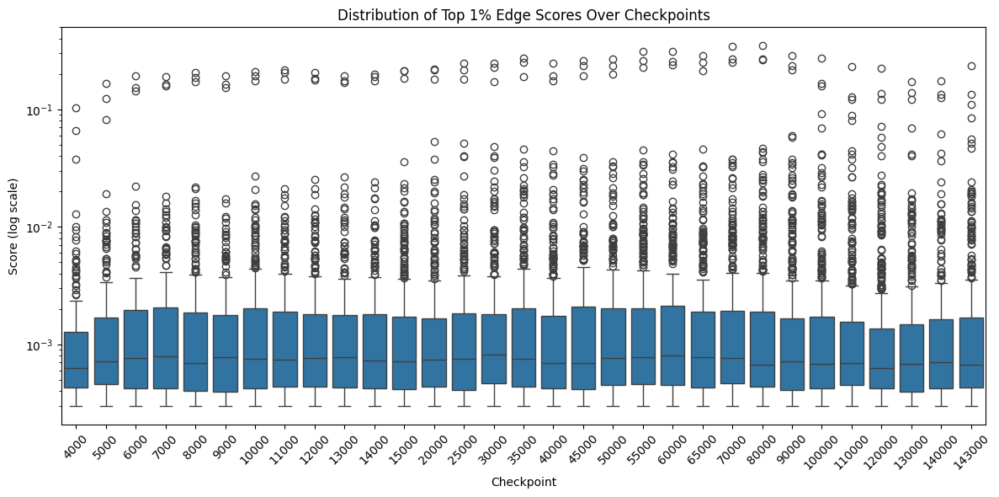

In [54]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Filter out scores below a certain threshold
threshold = df['score'].quantile(0.99)  # Adjust based on your data
filtered_df = df[df['score'] > threshold]

# Plot using seaborn with log scale
plt.figure(figsize=(12, 6))
sns.boxplot(x='checkpoint', y='score', data=filtered_df)
plt.yscale('log')
plt.title('Distribution of Top 1% Edge Scores Over Checkpoints')
plt.xlabel('Checkpoint')
plt.ylabel('Score (log scale)')
plt.xticks(rotation=45)  # Rotate checkpoint labels for better readability
plt.tight_layout()
plt.show()


In [55]:
import pandas as pd
from scipy.stats import entropy
from scipy.spatial.distance import jensenshannon

# Assuming `df` is your DataFrame with 'score', 'checkpoint', and 'edge' columns

# Reset the index
df.reset_index(inplace=True)

# Normalize the scores for each checkpoint
df['normalized_score'] = df.groupby('checkpoint')['score'].transform(lambda x: (x - x.min()) / (x.max() - x.min()))

# Set the index back to its original form
df.set_index('index', inplace=True)

# Calculate KL and JS divergence between consecutive checkpoints
checkpoints = sorted(df['checkpoint'].unique())
kl_divergences = []
js_divergences = []

for i in range(len(checkpoints) - 1):
    df1 = df[df['checkpoint'] == checkpoints[i]].set_index('edge')['normalized_score']
    df2 = df[df['checkpoint'] == checkpoints[i+1]].set_index('edge')['normalized_score']
    
    # Ensure that the distributions have the same shape and order
    df1, df2 = df1.align(df2, join='outer', fill_value=0)
    
    # Convert to numpy arrays for divergence calculations
    dist1 = df1.to_numpy()
    dist2 = df2.to_numpy()
    
    # Calculate KL Divergence - Note that this is not symmetric
    kl_div = entropy(dist1, dist2)
    kl_divergences.append(kl_div)
    
    # Calculate Jensen-Shannon Divergence - This is symmetric
    js_div = jensenshannon(dist1, dist2)
    js_divergences.append(js_div)


In [64]:
ioi_prob_diff = perf_metrics['pythia-160m']['ioi']['logit_diff']

In [65]:
# graph js_divergences with plotly express, with a log scale for the x axis

fig = px.line(x=checkpoints[1:], y=[js_divergences], title='Jensen-Shannon Divergence Between Consecutive Checkpoints (all edges)', log_x=True)

# Specify colors for each line
#colors = {'jaccard_similarity': 'lightblue'}

# Update each trace with the specified color
#for i, trace in enumerate(fig.data):
#    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=checkpoints[1:], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="JS Divergence"
)

fig.show()

In [59]:
# graph kl_divergences with plotly express, with a log scale for the x axis
fig = px.line(x=checkpoints[1:], y=kl_divergences, title='KL Divergence Between Consecutive Checkpoints')
fig.update_xaxes(type='log')

fig.show()

In [73]:
ged_results = compute_ged(df)

# plot additions, deletions, and total GED over time
fig = px.line(ged_results, x='checkpoint_2', y=['additions', 'deletions', 'total_ged'], title='GED Over Time (top 100 edges)', log_x=True)

# Specify colors for each line
colors = {'additions': 'lightgreen', 'deletions': 'lightsalmon', 'total_ged': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=ged_results['checkpoint_2'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="GED Metrics"
)

fig.show()

In [67]:
weighted_ged_results = compute_weighted_ged(df)

# plot weighted additions, deletions, and total weighted GED over time
fig = px.line(weighted_ged_results, x='checkpoint_2', y=['weighted_additions', 'weighted_deletions', 'total_weighted_ged'], title='Weighted GED Over Time (top 100 edges)', log_x=True)

# Specify colors for each line
colors = {'weighted_additions': 'lightgreen', 'weighted_deletions': 'lightsalmon', 'total_weighted_ged': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=ged_results['checkpoint_2'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="Weighted GED Metrics"
)

fig.show()

In [68]:
gtd_results = compute_gtd(df)

# plot weighted additions, deletions, and total weighted GTD over time
fig = px.line(gtd_results, x='checkpoint_2', y=['summed_increases', 'summed_decreases', 'summed_absolute_change'], title='Summed Changes Over Time (all edges)', log_x=True)

# Specify colors for each line
colors = {'summed_increases': 'lightgreen', 'summed_decreases': 'lightsalmon', 'summed_absolute_change': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=gtd_results['checkpoint_2'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="Summed Scores"
)

fig.show()

In [69]:
jaccard_results = compute_jaccard_similarity(df)

# plot jaccard similarity over time
fig = px.line(jaccard_results, x='checkpoint_2', y=['jaccard_similarity'], title='Jaccard Similarity Over Time', log_x=True)

# Specify colors for each line
colors = {'jaccard_similarity': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=jaccard_results['checkpoint_2'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="Jaccard Similarity"
)

fig.show()

In [70]:
jaccard_reference_results = compute_jaccard_similarity_to_reference(df, 5000)

# plot jaccard similarity over time
fig = px.line(jaccard_reference_results, x='checkpoint', y=['jaccard_similarity'], title='Jaccard Similarity Over Time (compared to step 5000)', log_x=True)

# Specify colors for each line
colors = {'jaccard_similarity': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=jaccard_reference_results['checkpoint'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="Jaccard Similarity"
)

fig.show()

In [71]:
jaccard_reference_results = compute_jaccard_similarity_to_reference(df, 140000)

# plot jaccard similarity over time
fig = px.line(jaccard_reference_results, x='checkpoint', y=['jaccard_similarity'], title='Jaccard Similarity Over Time (compared to step 140000)', log_x=True)

# Specify colors for each line
colors = {'jaccard_similarity': 'lightblue'}

# Update each trace with the specified color
for i, trace in enumerate(fig.data):
    fig.data[i].update(line=dict(color=colors[trace.name]))


# Convert to a go.Figure to add secondary Y-axis features
fig.update_layout(
    # Add a secondary Y-axis on the right
    yaxis2=dict(
        title="Probability Difference",
        overlaying="y",
        side="right",
        showgrid=False,  # Optional: Turn off gridlines for the secondary axis for clarity
    )
)

# Add the average_ged line on the secondary Y-axis
fig.add_trace(
    go.Scatter(x=jaccard_reference_results['checkpoint'], y=ioi_prob_diff, 
               name='prob_diff', mode='lines', yaxis='y2', line=dict(color='black'))
)

# Optional: Update the layout if you need to adjust titles or other aesthetics
fig.update_layout(
    yaxis_title="Jaccard Similarity"
)

fig.show()

In [96]:
for i, trace in enumerate(fig.data):
    print(trace.name)

jaccard_similarity
prob_diff


In [73]:
jaccard_results

,checkpoint_1,checkpoint_2,jaccard_similarity
0,1,2,0.931818
1,2,4,0.787234
2,4,8,0.788462
3,8,16,0.528571
4,16,32,0.637681
5,32,64,0.390805
6,64,128,0.481928
7,128,256,0.276190
8,256,512,0.073394
9,512,1000,0.000000


In [76]:
df = px.data.tips()
fig = px.violin(df,y="total_bill")
 
fig.show()

In [63]:
df.head

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3


In [25]:
from edge_attribution_patching.graph import  Graph
Graph.apply_threshold?

Signature: Graph.apply_threshold(self, threshold: float, absolute: bool)
Docstring: <no docstring>
File:      /notebooks/edge_attribution_patching/graph.py
Type:      function

In [54]:
transposed_df.agg(['mean', 'median', 'max', 'min'])

,checkpoint,0,1,2,3,4,5,6,7,8,...,32337,32338,32339,32340,32341,32342,32343,32344,32345,32346
mean,32233.093023,-0.000265,0.000038,0.000070,-0.000006,0.000003,-0.000150,0.000023,0.000005,0.000072,...,0.000260,-0.000063,9.750150e-05,0.001420,0.000559,0.000445,0.000091,0.000623,0.000291,0.004446
median,12000.000000,-0.000217,0.000010,0.000109,-0.000040,-0.000011,-0.000152,-0.000010,0.000005,0.000020,...,0.000019,-0.000007,9.126961e-07,0.001266,0.000679,0.000336,0.000004,0.000307,0.000427,0.003937
max,140000.000000,0.000072,0.000759,0.000353,0.001091,0.000364,0.000345,0.000637,0.000542,0.000591,...,0.001205,0.000144,1.502991e-03,0.003799,0.001984,0.001999,0.001183,0.003113,0.000801,0.024170
min,1.000000,-0.000813,-0.000595,-0.000324,-0.000793,-0.000184,-0.001083,-0.000387,-0.000336,-0.000431,...,-0.000278,-0.000553,-1.808167e-03,-0.000081,-0.000614,-0.001389,-0.000767,-0.000010,-0.000759,-0.005371


In [9]:
!pip install -U ridgeplot

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.2/48.2 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 2.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.9/233.9 kB 2.3 MB/s eta 0:00:00a 0:00:01


In [10]:
import numpy as np
from ridgeplot import ridgeplot
from ridgeplot.datasets import load_probly

# Load the probly dataset
df = load_probly()

# Let's grab the subset of columns used in the example
column_names = [
    "Almost Certainly",
    "Very Good Chance",
    "We Believe",
    "Likely",
    "About Even",
    "Little Chance",
    "Chances Are Slight",
    "Almost No Chance",
]
df = df[column_names]

# Not only does 'ridgeplot(...)' come configured with sensible defaults
# but is also fully configurable to your own style and preference!
fig = ridgeplot(
    samples=df.to_numpy().T,
    bandwidth=4,
    kde_points=np.linspace(-12.5, 112.5, 500),
    colorscale="viridis",
    colormode="row-index",
    coloralpha=0.65,
    labels=column_names,
    linewidth=2,
    spacing=5 / 9,
)

# And you can still update and extend the final
# Plotly Figure using standard Plotly methods
fig.update_layout(
    height=760,
    width=900,
    font_size=16,
    plot_bgcolor="white",
    xaxis_tickvals=[-12.5, 0, 12.5, 25, 37.5, 50, 62.5, 75, 87.5, 100, 112.5],
    xaxis_ticktext=["", "0", "", "25", "", "50", "", "75", "", "100", ""],
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="Assigned Probability (%)",
    showlegend=False,
)

# Show us the work!
fig.show()

In [32]:
import numpy as np
from ridgeplot import ridgeplot

fig = ridgeplot(
    samples=warp_df.to_numpy().T,
    bandwidth=4,
    kde_points=np.linspace(-25, 25, 1000),
    colorscale="viridis",
    colormode="row-index",
    coloralpha=0.65,
    labels=[str(label) for label in warp_df.columns.tolist()],
    linewidth=2,
    spacing=5 / 9,
)

fig.update_layout(
    height=1520,
    width=900,
    font_size=16,
    plot_bgcolor="white",
    xaxis_tickvals=[-25,-12.5, 0, 12.5, 25],
    xaxis_ticktext=["-25", "", "0", "", "25"],
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="EAP Score (Logit Difference)",
    showlegend=False,
    # transform y axis to log scale
    #yaxis_type="log"
)

In [35]:
from ridgeplot.datasets import load_lincoln_weather
df = load_lincoln_weather()
df[["Min Temperature [F]", "Max Temperature [F]"]].head()


,Min Temperature [F],Max Temperature [F]
2016-01-01,11,37
2016-01-02,5,41
2016-01-03,8,37
2016-01-04,4,30
2016-01-05,19,38


In [36]:
months = df.index.month_name().unique()
months.to_list()

['January',
 'February',
 'March',
 'April',
 'May',
 'June',
 'July',
 'August',
 'September',
 'October',
 'November',
 'December']

In [37]:
samples = [
    [
        df[df.index.month_name() == month]["Min Temperature [F]"],
        df[df.index.month_name() == month]["Max Temperature [F]"],
    ]
    for month in months
]

In [43]:
len(samples), len(samples[0]), samples[0][1].shape

(12, 2, (31,))